Variational Autoencoder for WaveTable Generation (using Lightning)
======

The VAE implemented here uses the setup found in most VAE papers: a multivariate Normal distribution for the conditional distribution of the latent vectors given and input image ($q_{\phi}(z | x_i)$ in the slides) and a multivariate Bernoulli distribution for the conditional distribution of images given the latent vector ($p_{\theta}(x | z)$ in the slides). Using a Bernoulli distribution, the reconstruction loss (negative log likelihood of a data point in the output distribution) reduces to the pixel-wise binary cross-entropy. See the [original VAE paper](https://arxiv.org/pdf/1312.6114.pdf), Appendix C.1 for details.

We use Lightning to make it easier to develop for an ARM M7 processor, doing pruning and quantization.

In [147]:
import sys
# %pip install torch>=1.2.0
# %pip install torchaudio
# %pip install pytorch-lightning


import numpy as np
import os
import matplotlib.pyplot as plt
%matplotlib inline
import torch
import torchvision
import torchaudio as audio
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from pytorch_lightning.core.lightning import LightningModule

# %load_ext tensorboard
# import tensorflow as tf
# import datetime

class UnlabeledTensorDataset(Dataset):
    """Dataset wrapping unlabeled data tensors (autoencoders do not need labels).

    Each sample will be retrieved by indexing tensors along the second
    dimension.

    Arguments:
        data_tensor (Tensor): contains sample data.
    """
    def __init__(self, data_tensor, num_waves):
        self.data_tensor = data_tensor
        self.samples = list(range(1, num_waves))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, index):
        return self.data_tensor[:,index]

def normalize(tensor):
    # Shift and scale to the interval [0,1]
    tensor_minusmin = tensor - tensor.min()
    tensor_maxminusmin = tensor.max() - tensor.min()
    return tensor_minusmin/tensor_maxminusmin

def shift_normalize(tensor):
    # Shift and scale to the interval [-1,1]
    tensor_minusmin = tensor - tensor.min()
    tensor_maxminusmin = tensor.max() - tensor.min()
    return -1+2*tensor_minusmin/tensor_maxminusmin

Parameter Settings
-------------------


In [148]:
latent_dims = 3
wave_size = 256
wave_sized2 = 128
wave_sized4 = 64
num_epochs = 1500
batch_size = 128
capacity = 16
learning_rate = 1e-3
variational_beta = 1
use_gpu = True

Setting the WAV directory
--------------------------

In [149]:
wav_dir = "./WAV/Various-ups-downs/"
wav_file = "VARIOUS_.WAV"
wav_file = os.path.join(wav_dir, wav_file)

In [150]:
model_dir_name = "model-tanh-"+str(num_epochs)
model_name = model_dir_name+".pt"
model_dir = os.path.join(wav_dir,model_dir_name)
if not os.path.exists(model_dir):
    os.mkdir(model_dir)
else:
    print("Directory exists.")

Directory exists.


WAV Data Loading
-------------------

Read banks of single-cycle waves.
Each wave file (*.wav) includes 'Nwaves' individual 'wave_size'-sample single-cycle waveforms (a "bank").
Normalize each wave to be between 0 and 1, because we will be using a binary cross-entropy loss that treats pixel values as probabilities in [0,1]. We create only a training set because we are only interested in using the decoder in our application.

In [221]:
waves = torch.empty(size=(wave_size,1000*64))
num_waves = 0
import glob
for name in glob.glob(wav_file):
    print(name)
    wavebank, sample_rate = audio.load(name)
    Nsamp = wavebank.size()
    for i in range(64):
        waveform = wavebank[0,i*wave_size:i*wave_size+wave_size]
        if waveform.max() != waveform.min() :
            waveform = normalize(waveform)
            waves[:,num_waves] = waveform
            num_waves += 1
train_dataset = UnlabeledTensorDataset(waves[:,1:num_waves], num_waves)
train_dataset_file_name = "train_dataset"
torch.save(train_dataset,os.path.join(wav_dir,train_dataset_file_name))

./WAV/Various-ups-downs/VARIOUS_.WAV


VAE Definition
-----------------------
We use a convolutional encoder and decoder, which generally gives better performance than fully connected versions that have the same number of parameters.

In convolution layers, we increase the channels as we approach the bottleneck, but note that the total number of features still decreases, since the channels increase by a factor of 2 in each convolution, but the spatial size decreases by a factor of 4.

Kernel size 4 is used to avoid biasing problems described here: https://distill.pub/2016/deconv-checkerboard/

In [222]:
class Encoder(nn.Module):
    def __init__(self):
        super(Encoder, self).__init__()
        c = capacity
        self.conv1 = nn.Conv1d(in_channels=1, out_channels=c, kernel_size=4, stride=2, padding=1) # out: c x wave_size/2
        self.conv2 = nn.Conv1d(in_channels=c, out_channels=c*2, kernel_size=4, stride=2, padding=1) # out: c x wave_size/4
        self.fc_mu = nn.Linear(in_features=c*wave_sized2, out_features=latent_dims)
        self.fc_logvar = nn.Linear(in_features=c*wave_sized2, out_features=latent_dims)
            
    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = x.view(x.size(0), -1) # flatten batch of multi-channel feature maps to a batch of feature vectors
        x_mu = self.fc_mu(x)
        x_logvar = self.fc_logvar(x)
        return x_mu, x_logvar

class Decoder(nn.Module):
    def __init__(self):
        super(Decoder, self).__init__()
        c = capacity
        self.fc = nn.Linear(in_features=latent_dims, out_features=c*wave_sized2)
        self.conv2 = nn.ConvTranspose1d(in_channels=c*2, out_channels=c, kernel_size=4, stride=2, padding=1)
        self.conv1 = nn.ConvTranspose1d(in_channels=c, out_channels=1, kernel_size=4, stride=2, padding=1)
            
    def forward(self, x):
        x = self.fc(x)
        x = x.view(x.size(0), capacity*2, wave_sized4) # unflatten batch of feature vectors to a batch of multi-channel feature maps
#        x = x.view(1, 32, 64) #### need to hardcode the shape in view to satisfy loading in onnx.js !!! ####
        x = F.relu(self.conv2(x))
        x = torch.sigmoid(self.conv1(x)) # last layer before output is sigmoid, since we are using BCE as reconstruction loss
        return x
    
class LitVariationalAutoencoder(LightningModule):
    def __init__(self):
        super().__init__()
        self.encoder = Encoder()
        self.decoder = Decoder()
        self.loss = []
        self.recon_loss = []
    
    def forward(self, x):
        latent_mu, latent_logvar = self.encoder(x)
        latent = self.latent_sample(latent_mu, latent_logvar)
        x_recon = self.decoder(latent)
        return x_recon, latent_mu, latent_logvar
    
    def latent_sample(self, mu, logvar):
        if self.training:
            # the reparameterization trick
            std = logvar.mul(0.5).exp_()
            eps = torch.empty_like(std).normal_()
            return eps.mul(std).add_(mu)
        else:
            return mu

    def training_step(self, wave_batch, batch_idx):
        wave_batch = wave_batch.unsqueeze(1)
        wave_batch_recon, latent_mu, latent_logvar = self(wave_batch)
        recon_loss, loss = vae_loss(wave_batch_recon, wave_batch, latent_mu, latent_logvar)

        self.log('training loss', loss, on_step=True, on_epoch=True, logger=True)
        self.loss.append(loss)
        self.recon_loss.append(recon_loss)
        return loss

    def configure_optimizers(self):
        return Adam(self.parameters(), lr=learning_rate, weight_decay=1e-5)        

def vae_loss(recon_x, x, mu, logvar):
    # recon_x is the probability of a multivariate Bernoulli distribution p.
    # -log(p(x)) is then the pixel-wise binary cross-entropy.
    # Averaging or not averaging the binary cross-entropy over all samples here
    # is a subtle detail with big effect on training, since it changes the weight
    # we need to pick for the other loss term by several orders of magnitude.
    # Not averaging is the direct implementation of the negative log likelihood,
    # but averaging makes the weight of the other loss term independent of the wave resolution.

    recon_loss = F.binary_cross_entropy(recon_x.view(-1, wave_size), x.view(-1, wave_size), reduction='sum')
    
    # KL-divergence between the prior distribution over latent vectors
    # (the one we are going to sample from when generating new waves)
    # and the distribution estimated by the generator for the given wave.
    kldivergence = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

    # Total variation loss.
    tv_loss = torch.sum(torch.pow(recon_x[:,:,:-1] - recon_x[:,:,1:], 2))
    
    return recon_loss, recon_loss + variational_beta * kldivergence + 100.01 * tv_loss
    
from pytorch_lightning import Trainer
from torch.optim import Adam

vae = LitVariationalAutoencoder()

c:\Users\jerem\AppData\Local\Programs\Python\Python310\lib\site-packages\pytorch_lightning\core\lightning.py:22: LightningDeprecationWarning: pytorch_lightning.core.lightning.LightningModule has been deprecated in v1.7 and will be removed in v1.9. Use the equivalent class from the pytorch_lightning.core.module.LightningModule class instead.
  rank_zero_deprecation(


Train VAE
--------

In [202]:
if not train_dataset:
    train_dataset = torch.load(os.path.join(wav_dir,train_dataset_file_name))
else:
    print(f"Training data already loaded")
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

Training data already loaded


In [216]:
train_dataset.__len__()

63

In [203]:
trainer = Trainer(accelerator='gpu', devices=1, max_epochs=3000)
trainer.fit(vae, train_dataloader)

torch.save(vae.state_dict(), os.path.join(model_dir, model_name))
#%tensorboard --logdir lightning_logs

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type    | Params
------------------------------------
0 | encoder | Encoder | 14.5 K
1 | decoder | Decoder | 10.3 K
------------------------------------
24.8 K    Trainable params
0         Non-trainable params
24.8 K    Total params
0.099     Total estimated model params size (MB)


Epoch 2999: 100%|██████████| 1/1 [00:00<00:00, 52.77it/s, loss=1.09e+04, v_num=22] 

`Trainer.fit` stopped: `max_epochs=3000` reached.


Epoch 2999: 100%|██████████| 1/1 [00:00<00:00, 33.42it/s, loss=1.09e+04, v_num=22]


In [195]:
# plt.plot(vae.loss[0].cpu())
vae_loss = []
vae_recon_loss = []
for i in vae.loss:
    vae_loss.append(i.cpu().detach().numpy())
for i in vae.recon_loss:
    vae_recon_loss.append(i.cpu().detach().numpy())


Text(0.5, 1.0, 'Loss')

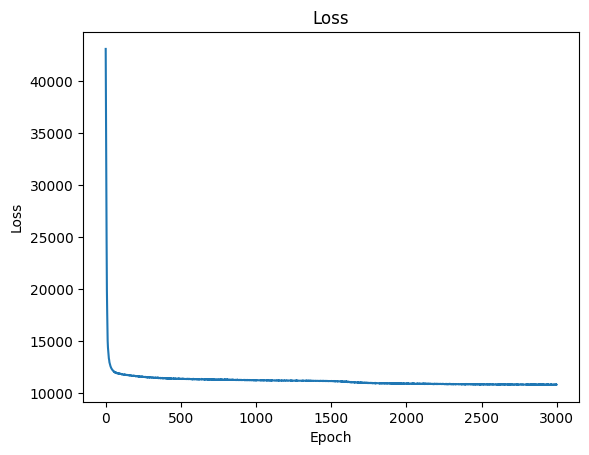

In [196]:
plt.plot(vae_loss)
plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.title("Loss vs Epoch")

Text(0.5, 1.0, 'Reconstruction Loss')

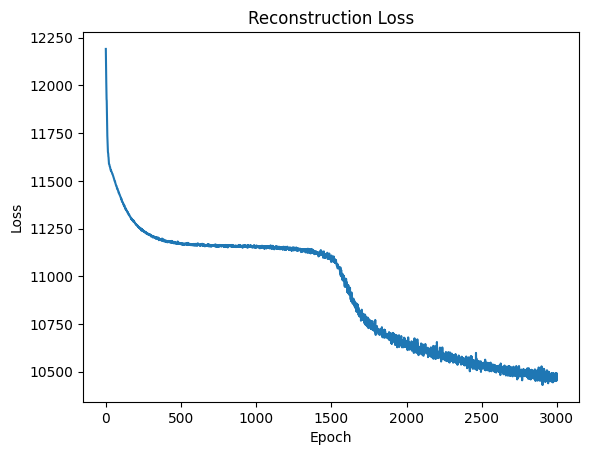

In [197]:
plt.plot(vae_recon_loss)
plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.title("Reconstruction Loss")

Alternatively: Load Saved Pre-Trained VAE Model
-----------------------------

In [155]:
# homepath = r"E:\Users\owner\Documents\cylonix\wavae\notebooks"
# os.chdir(homepath)
# filename = './wave_vae_SYNLP.pth'

# vae.load_state_dict(torch.load(filename))
# print('done')

Sample Latent Vector from Prior (VAE as Generator)
-------------------------------------------------

A VAE can generate new waveforms by drawing latent vectors from the prior distribution. 

Similar to autoencoders, the manifold of latent vectors that decode to valid digits is sparser in higher-dimensional latent spaces. Increasing the weight of the KL-divergence term in the loss (increasing `variational_beta`) makes the manifold less sparse at the cost of a lower-quality reconstruction.

tensor([[-0.9591,  1.3353,  0.3147]])


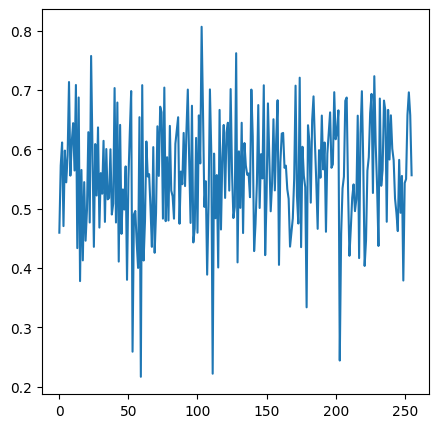

In [156]:
# plot a single 256-sample waveform generated by the decoder corresponding to a random latent space value
vae.eval()

with torch.no_grad():

    # sample latent vector from the normal distribution
    latent = 1.50*torch.randn(1, latent_dims)
    print(latent) # print the latent space vector

    # reconstruct wave from the latent vector
    wave_recon = vae.decoder(latent)
    wave_recon = wave_recon.cpu()

    fig, ax = plt.subplots(figsize=(5, 5))
    plt.plot(wave_recon[0,:].t().numpy())
    plt.show()
    

Plot Random Latent Space Grid Points
---------------------

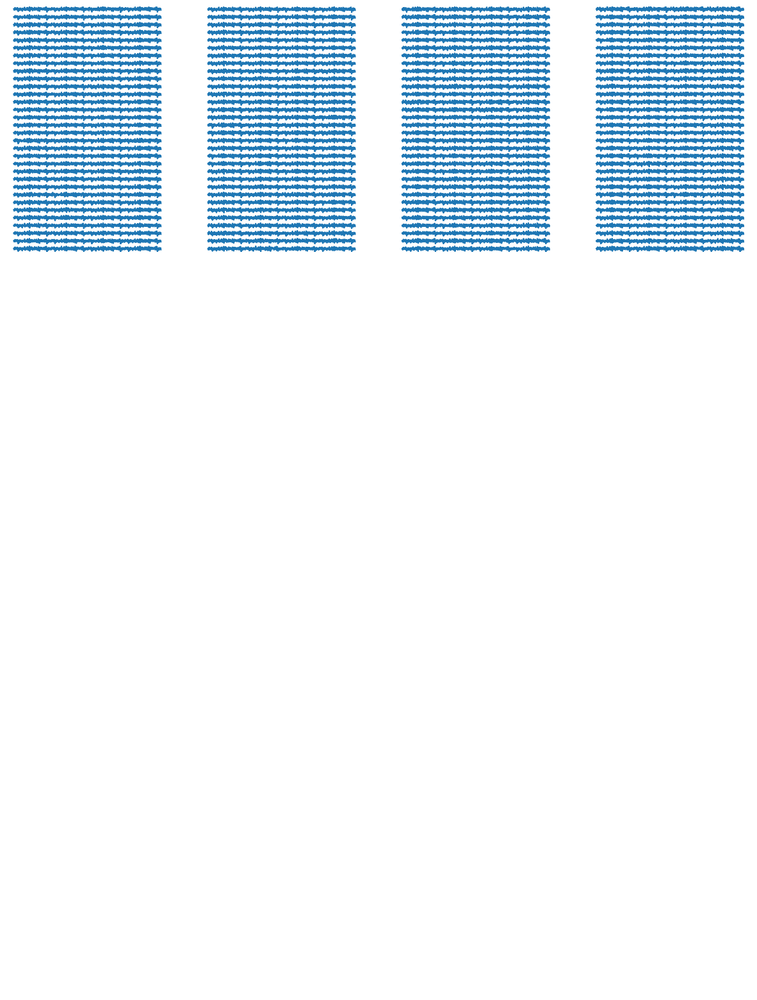

In [157]:
with torch.no_grad():
    rg = 0.0 + np.random.rand()*2.2

    latents = torch.FloatTensor(latent_dims, 16).uniform_(0, rg)
    latents = rg*torch.randn(512, latent_dims) # generate random latent samples

# reconstruct waves from the latent vectors
    wave_recon = vae.decoder(latents)
    wave_recon = wave_recon.cpu()
    wave_recon2 = wave_recon.view(128,1,1024) # combine 4 waves into 1
    num_generated_waves = 128
    num_wav_cols = 4

    fig, ax = plt.subplots(figsize=(15, 20))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)    
    ax.get_xaxis().set_ticks([])
    ax.get_yaxis().set_ticks([])
    for i in range(num_generated_waves):
        ax = fig.add_subplot(num_generated_waves, num_wav_cols, i+1)
        ax.axis('off')
        plt.plot(wave_recon2[i,0,:].t().numpy())
    plotfilename = os.path.join(model_dir, "random-waves.png")
    plt.savefig(plotfilename)
    plt.show()

# 512 256-sample waves are generated with random latent space values
# to make the wves more interesting, we merge four 256-sample waves into one longer wave
# combining 4 at a time leaves us with 128 waves of size 1024 samples.
# these are plotted as 32 rows each with 4 waves

Plot and Save smooth morphed wave banks 
---------------------

In [158]:
# GENERATED_WAV
assert model_dir is not None
wav_bank_dir = os.path.join(model_dir, 'wav_bank')
if not os.path.exists(wav_bank_dir):
    os.mkdir(wav_bank_dir)
else:
    print("Directory exists.")

Directory exists.


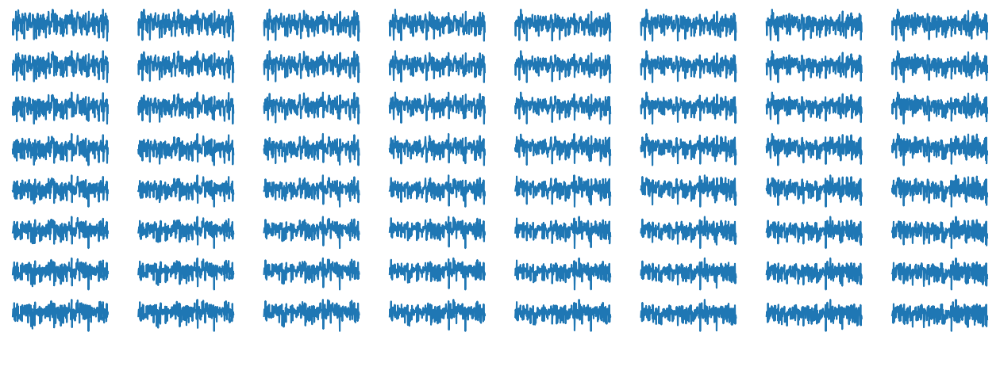

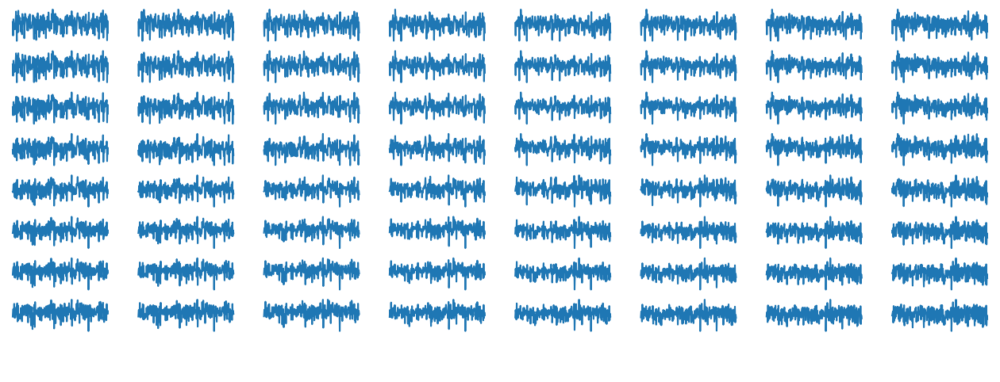

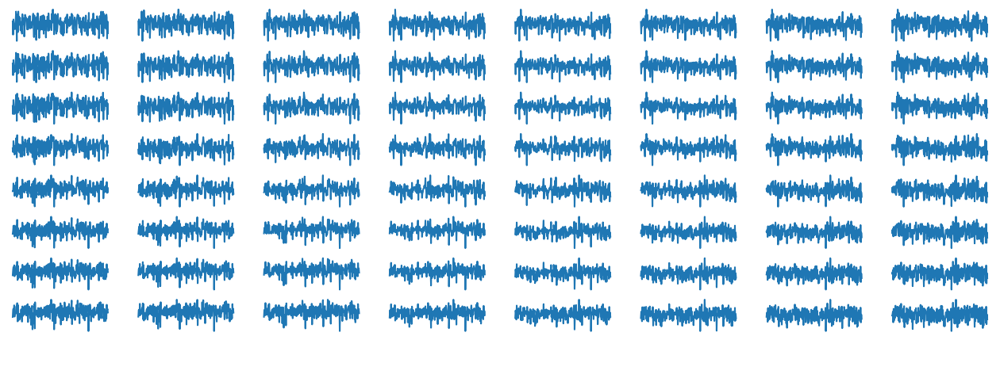

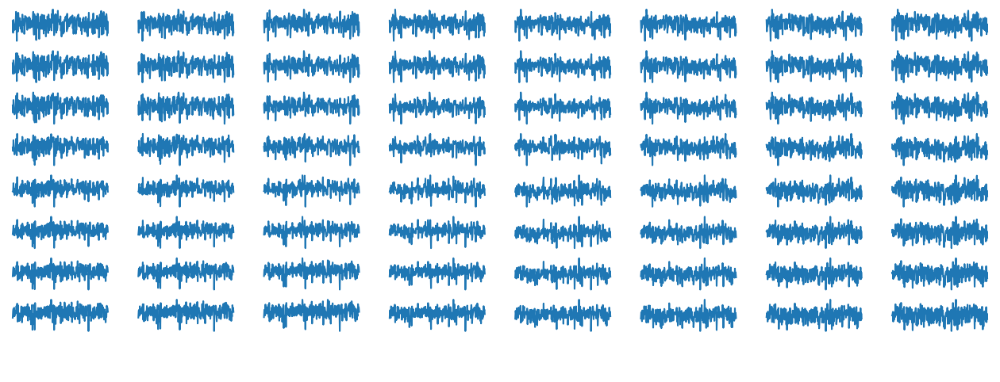

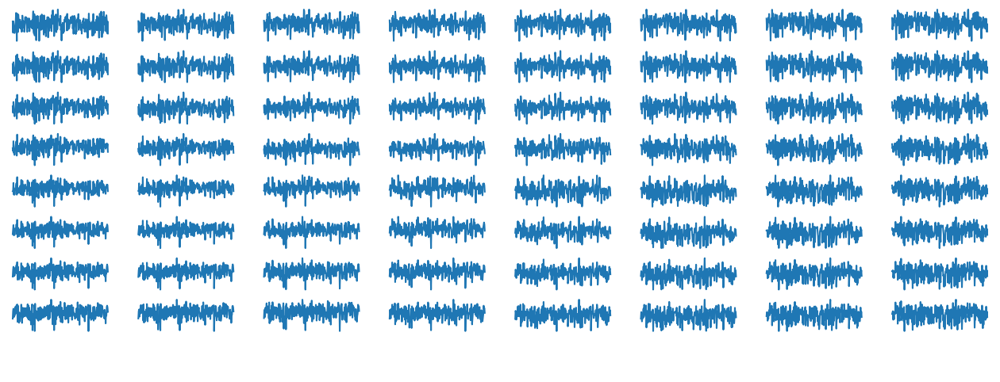

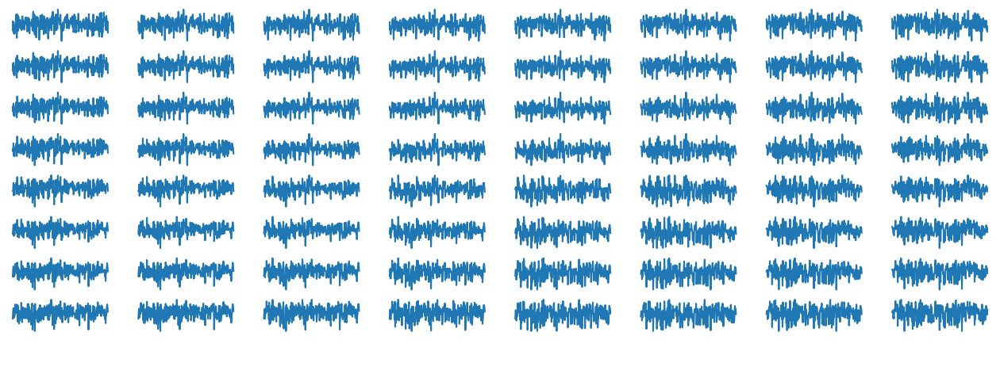

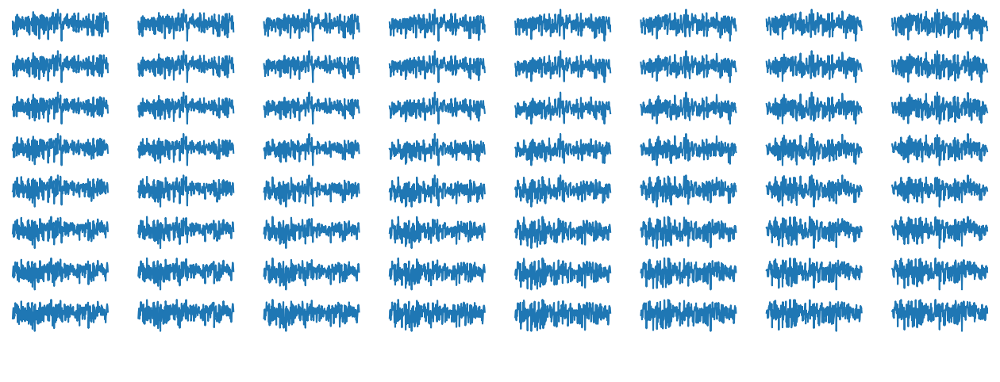

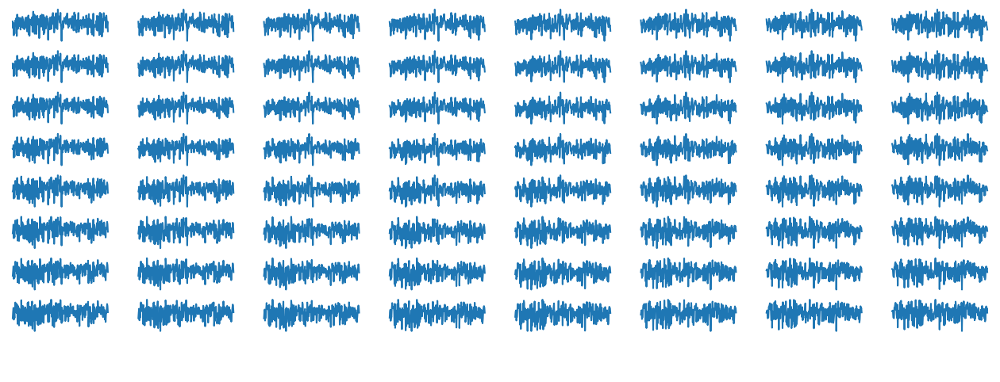

In [159]:
# generates 8 sets of 64 waves of length 256 samples each (so 512 waves in total)
# the latent space is sampled uniformly over a fixed range over just 3 of the latent space dimensions. All of the other
# latent space dimension values are set to random values (which are the same for all waves)
# This gives morphing between the waves (rather than random waves)
# these are combined into 8 wavebank files each of length 16K samples. 
# Each sample is in single precision floating point, so 4 bytes per sample. Total wavebank size is therefore 64KBytes.
# each of the 8 wavebanks is saved in .wav format

with torch.no_grad():
    rg = 0.0 + np.random.rand()*2.2

    slatent = rg*torch.randn(1, latent_dims) # generate random latent samples (all the same)
    latents = slatent.repeat(512,1)
    # create a uniform sample grid in 3 dimensions of the latent space
    latent_x = np.linspace(-2,2,8)
    latent_y = np.linspace(-2,2,8)
    latent_z = np.linspace(-2,2,8)
#    latents = torch.FloatTensor(len(latent_z), len(latent_y), len(latent_x), 3)
    for i, lx in enumerate(latent_x):
        for j, ly in enumerate(latent_y):
            for k, lz in enumerate(latent_z):
                latents[k*64+j*8+i, 0] = lx
                latents[k*64+j*8+i, 1] = ly
                latents[k*64+j*8+i, 2] = lz

    # reconstruct waves from the latent vectors
    wave_recon = vae.decoder(latents)
    wave_recon = wave_recon.cpu()

    wavebank = torch.empty(size=(1,wave_size*64))
    sr = 44100
    for zz in range(0,8):
        for i in range(0, 64):
            wave = wave_recon[i+zz*64,0,:]
            wave = shift_normalize(wave)
            wavebank[0,i*wave_size:i*wave_size+wave_size] = wave

        wavebankfilename = "up_downs_bank{}.wav".format(zz)
        audio.save(os.path.join(wav_bank_dir,wavebankfilename), wavebank, sr)

        # plot the waves (one set of plots for each of the 8 banks)
        fig, ax = plt.subplots(figsize=(16, 6))
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)    
        ax.get_xaxis().set_ticks([])
        ax.get_yaxis().set_ticks([])
        for i in range(64):
            ax = fig.add_subplot(9, 8, i+1)
            ax.axis('off')
            plt.plot(wave_recon[i+zz*64,0,:].t().numpy())
        plotfilename = "latent_waves_{}.png".format(zz)
        plt.savefig( os.path.join(wav_bank_dir,plotfilename))
        plt.show()


# Export decoder model to ONNX

In [160]:
#NOTE: the ONNX export does not handle batch inputs to the networks.
# so the VAE definition has to be modified to just have single inputs (see VAE definition section - uncomment and comment
# out the appropriate statements)
# note that if you do this modification, then the above code blocks for generating random and morphed wavesets will break

import torch.onnx 

dummy_input = torch.randn(1,latent_dims)
vae.decoder.eval()
torch.onnx.export(vae.decoder, 
                  dummy_input,
                  os.path.join(model_dir, model_dir_name+".onnx"),
                  verbose=True,
                  input_names = ['modelInput'],   # the model's input names 
                  output_names = ['modelOutput'], # the model's output names 
                  opset_version=11,
                  export_params=True,
                  )

# Generating a Trace of the model for porting to C++

In [161]:
#import torch
#import torchvision

# An instance of your model.
model = vae.decoder

# An example input you would normally provide to your model's forward() method.
example = torch.rand(1, latent_dims)

# Use torch.jit.trace to generate a torch.jit.ScriptModule via tracing.
traced_script_module = torch.jit.trace(model, example)

In [187]:
traced_script_module = torch.jit.trace(vae.encoder, train_dataset)

TypeError: Encoder.forward() takes 2 positional arguments but 64 were given

In [207]:
traced_script_module

Decoder(
  original_name=Decoder
  (fc): Linear(original_name=Linear)
  (conv2): ConvTranspose1d(original_name=ConvTranspose1d)
  (conv1): ConvTranspose1d(original_name=ConvTranspose1d)
)